In [1]:
%pip install leidenalg
%pip install igraph
%pip install pycairo

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [2]:
import leidenalg as la
import igraph as ig
import pandas as pd
import matplotlib.pyplot as plt


In [3]:
# edges = pd.read_csv('citationNetworks/Data/edges/edgeList.csv')

# read data in
# MLData = pd.read_csv("citationNetworks/Data/ML/autoScreenedML.csv")
# CTData = pd.read_csv("citationNetworks/Data/CT/autoScreenedCT.csv")
#MLData = pd.DataFrame(MLData)
# MLData.insert(0, 'search', 2)
# CTData.insert(0, 'search', 1)
# MLData.insert(0, 'search', 'ML')
# CTData.insert(0, 'search', 'CT')
# MLData.insert(0, 'label', 'ML')
# CTData.insert(0, 'label', 'CT')
# MLData.insert(0, 'color', 'gold')
# CTData.insert(0, 'color', 'blue')
#MLData['search'] <- '2'
# CTData['search'] <- 1
# MLData['label'] <- "ML"
# CTData['label'] <- "CT"
# MLData['color'] <- "gold"
# CTData['color'] <- "blue"

In [4]:
# fullData = pd.merge(MLData, CTData) 
# fullData
#names(fullData)[names(fullData) == "X"] <- "ID"
#colnames(fullData)
#fullData$ID <- 1:nrow(fullData)
#fullData$search <- as.numeric(fullData$search)
#colnames(edges)
#edges <- edges[c("CitingID", "CitedID")]
#colnames(edges)

In [5]:
# data read in
edges = pd.read_csv('citationNetworks/Data/edges/edgeList.csv')
fullData = pd.read_csv("citationNetworks/Data/dataForPythonModules.csv")

In [6]:
edges
edges = edges.drop(['Unnamed: 0'], axis=1)
edges

,CitingID,CitedID
0,4,272
1,1430,272
2,1558,272
3,3020,272
4,3906,272
...,...,...
37579,4917,2537
37580,5062,2537
37581,5556,4815
37582,5345,5346


In [7]:
# tuples = [tuple(x) for x in edges.values]
# g = ig.Graph.TupleList(edges, directed=True)
g = ig.Graph.TupleList(edges.itertuples(index=False), directed=True, weights=False)
print(g)
g1 = g.copy()
g1.simplify()

IGRAPH DN-- 5677 37584 --
+ attr: name (v)
+ edges (vertex names):
   4 -> 272, 5774
 272 ->
1430 -> 272
1558 -> 272, 3450
3020 -> 272, 1250, 3588
3906 -> 272, 3450
5867 -> 272, 1250, 3588
  54 -> 272, 3020, 5867
 145 -> 272, 3020, 5867
1802 -> 272, 1802, 4203, 3253
2060 -> 272, 354, 97, 404, 1181, 2752, 806, 2427, 2898, 5723, 1022, 4251
2210 -> 272, 1558, 3906, 2556, 5251, 5987, 3376, 6300, 3450, 4742, 4320
2720 -> 272, 1558, 3906, 63, 2171, 2171, 2171, 2171, 2171, 2171, 2171, 2171,
2171, 2171, 2171, 2171, 2171, 2171, 2171, 2171, 4251
3192 -> 272, 1430, 2884, 5716, 3356
4203 -> 272, 1802, 4203, 3253
4576 -> 272, 354, 97, 404, 1181, 2752, 806, 2427, 2898, 5723, 1022, 4251
4741 -> 272, 1558, 3906, 2556, 5251, 5987, 3376, 6300, 3450, 4742, 4320
6085 -> 272, 1430, 2884, 5716, 3356
 354 -> 4, 272, 3192, 6085, 2374, 5009, 3190, 6084, 1081, 2884, 5716, 2882,
2171
2374 -> 272, 1558, 3906, 3192, 6085, 2556, 5251, 4658, 1928, 4393, 2170, 4683,
6083, 1081, 3391, 2884, 5716, 3450, 1198, 352, 1047

In [8]:
# G = ig.Graph.DictList(
#           vertices=fullData.to_dict('records'),
#           edges=edges.to_dict('records'),
#           directed=True,
#           vertex_name_attr='id',
#           edge_foreign_keys=('source', 'target'))

In [9]:
# graph construction 
nodes = fullData["ID"]
# titles = fullData[["ID", "title"]]
# authors = fullData[["ID", "author"]]
# journal =  fullData[["ID", "source_title"]]
# year = fullData[["ID", "year"]]
# search = fullData[["ID", "search"]]
# label = fullData[["ID", "label"]]
# color = fullData[["ID", "color"]]
# references = fullData[["ID", "references"]]

titles = fullData["title"]
authors = fullData["author"]
journal =  fullData["source_title"]
year = fullData["year"]
search = fullData["search"]
label = fullData["label"]
color = fullData["color"]
references = fullData["references"]

In [10]:
g1.vs["ID"] = nodes
# g.vs["title"] = titles
# g.vs["author"] = authors
g1.vs["year"] = year
g1.vs["search"] = search
# g.vs["label"] = label
g1.vs["color"] = color


In [11]:
print(g1)

IGRAPH DN-- 5677 36434 --
+ attr: ID (v), color (v), name (v), search (v), year (v)
+ edges (vertex names):
   4 -> 272, 5774
 272 ->
1430 -> 272
1558 -> 272, 3450
3020 -> 272, 1250, 3588
3906 -> 272, 3450
5867 -> 272, 1250, 3588
  54 -> 272, 3020, 5867
 145 -> 272, 3020, 5867
1802 -> 272, 4203, 3253
2060 -> 272, 354, 97, 404, 1181, 2752, 806, 2427, 2898, 5723, 1022, 4251
2210 -> 272, 1558, 3906, 2556, 5251, 5987, 3376, 6300, 3450, 4742, 4320
2720 -> 272, 1558, 3906, 63, 2171, 4251
3192 -> 272, 1430, 2884, 5716, 3356
4203 -> 272, 1802, 3253
4576 -> 272, 354, 97, 404, 1181, 2752, 806, 2427, 2898, 5723, 1022, 4251
4741 -> 272, 1558, 3906, 2556, 5251, 5987, 3376, 6300, 3450, 4742, 4320
6085 -> 272, 1430, 2884, 5716, 3356
 354 -> 4, 272, 3192, 6085, 2374, 5009, 3190, 6084, 1081, 2884, 5716, 2882,
2171
2374 -> 272, 1558, 3906, 3192, 6085, 2556, 5251, 4658, 1928, 4393, 2170, 4683,
6083, 1081, 3391, 2884, 5716, 3450, 1198, 352, 1047
5009 -> 272, 1558, 3906, 3192, 6085, 2556, 5251, 4658, 1928,

In [12]:
#fig, ax = plt.subplots()
# layout = g.layout_kamada_kawai()
layout = g1.layout_lgl()
# layout = g.layout_fruchterman_reingold()
ig.plot(g1, layout = layout)
# cool looks basically correct 

In [13]:
# calculate modularity
partition = la.find_partition(g1, la.ModularityVertexPartition)
ig.plot(partition)

In [25]:
print(partition)

Clustering with 5677 elements and 93 clusters
[ 0] 4, 272, 1430, 1558, 3906, 2060, 2210, 2720, 3192, 4576, 4741, 6085, 354,
     2374, 5009, 460, 590, 870, 2998, 5843, 1572, 1614, 3971, 2178, 4692,
     2274, 2744, 2970, 5800, 2962, 1956, 5790, 2829, 3280, 1848, 5011, 944,
     2813, 5171, 108, 321, 3464, 6372, 1034, 3061, 1898, 4349, 1896, 4346, 26,
     73, 48, 129, 634, 1937, 636, 724, 1774, 2173, 4160, 1096, 3227, 1098,
     2708, 3216, 3233, 5458, 6131, 2846, 5675, 2706, 2820, 5634, 2870, 5690,
     3452, 52, 3190, 6084, 184, 270, 292, 334, 1702, 2358, 2564, 3270, 6209,
     960, 518, 730, 852, 1469, 1894, 2946, 3124, 6001, 536, 686, 1559, 2712,
     674, 2065, 676, 2063, 728, 2346, 736, 2702, 3068, 1084, 1162, 3421, 1086,
     3193, 1776, 3428, 1598, 1772, 2644, 2742, 3000, 3024, 4159, 5507, 2124,
     2226, 4765, 3164, 3194, 6086, 3310, 6242, 3312, 6243, 1406, 752, 2275,
     1524, 3863, 996, 1388, 1972, 2900, 5611, 822, 826, 416, 1195, 476, 1377,
     1062, 3147, 2114, 2180, 33

In [16]:
help(g.rewire)

Help on built-in function rewire:

rewire(n=1000, mode='simple') method of igraph.Graph instance
    Randomly rewires the graph while preserving the degree distribution.
    
    Please note that the rewiring is done "in-place", so the original
    graph will be modified. If you want to preserve the original graph,
    use the L{copy} method before.
    
    @param n: the number of rewiring trials.
    @param mode: the rewiring algorithm to use. It can either be C{"simple"} or
      C{"loops"}; the former does not create or destroy loop edges while the
      latter does.



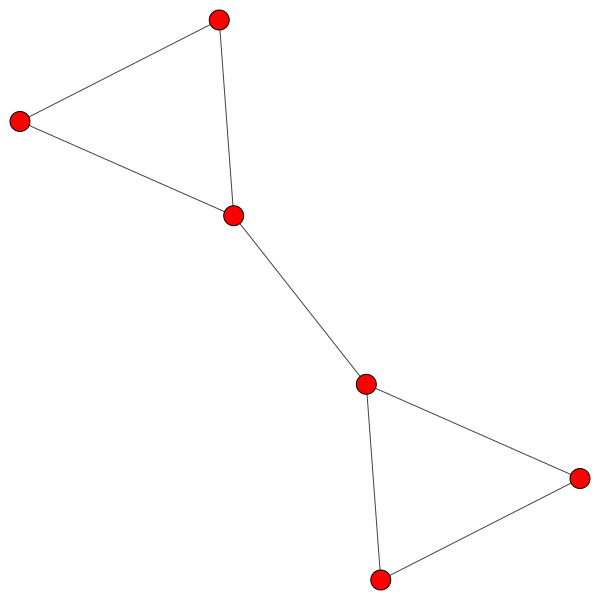

In [21]:
# do the rewiring? 

# do a little 10 item demo 
# gDemo = ig.Graph()
# gDemo.add_vertices(3)
# gDemo.add_edges([(0,1), (1,2)])
# gDemo.add_edges([(2, 0)])
# gDemo.add_vertices(3)
# gDemo.add_edges([(2, 3), (3, 4), (4, 5), (5, 3)])
# ig.plot(gDemo)


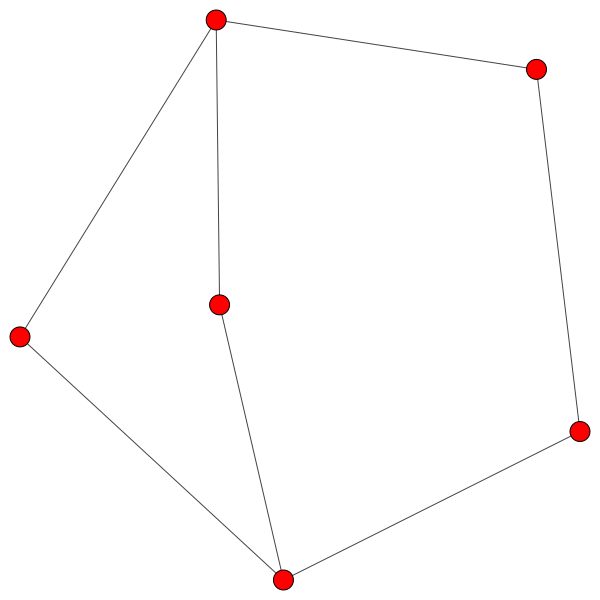

In [22]:
# gDemo.rewire(n=gDemo.vcount()*10)
# ig.plot(gDemo)

(array([  10.,   87.,  474., 1536., 2847., 2843., 1651.,  488.,   59.,
           5.]),
 array([0.23667909, 0.23769315, 0.23870721, 0.23972128, 0.24073534,
        0.2417494 , 0.24276346, 0.24377752, 0.24479159, 0.24580565,
        0.24681971]),
 <BarContainer object of 10 artists>)

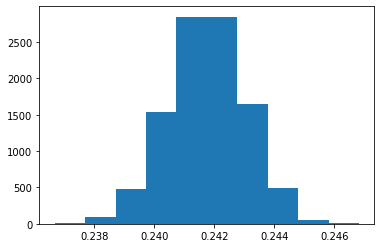

In [29]:
g2 = g1.copy()
originalModularity = g1.modularity(partition)
print(originalModularity)

# g2.rewire(n=g2.vcount()*10)

modularityList = list()
for i in range(10000):
    g2.rewire(n=g2.vcount()*10)
    partition = la.find_partition(g2, la.ModularityVertexPartition)
    # membership = partition.membership() # need to work out what partition actually is 
    modularity = g2.modularity(partition)
    modularityList.append(modularity)
plt.hist(modularityList)

# modularityList <- c()
# for (i in 1:10) { # 10000
#         # graph <- sample_gnm(6372, 37584, directed = FALSE, loops = FALSE) # where is degree in there? 
#         # needs to maintain both in- and out-degree
#         # igraph_rewire() ???
#         # degree.distribution()
#         # graph should be directed!!!
#         graph <- rewire(net, with = keeping_degseq(niter = vcount(net) * 10))
#         # graphCluster <- cluster_louvain(graph)
#         # graphCluster <- edge.betweenness(graph)
#         graphCluster <- edge.betweenness.community(graph)
#         graphMembers <- igraph::membership(graphCluster)
#         graphModularity <- modularity(graph, graphMembers)
#         modularityList <- append(modularityList, graphModularity)
# }